In [1]:
import squidpy as sq

In [2]:
import argparse
import configparser
from pathlib import Path

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from anndata import read_h5ad
from scipy import stats

In [3]:
DATA_PATH = Path("../data/pfizer/test_results")

test_adata = read_h5ad(DATA_PATH / "prediction.h5ad")

comm_genes = ["SLITRK6", "PGM5", "LINC00645",
                          "TTLL12", "COX6C", "CPB1",
                          "KRT5", "MALAT1"]
n_genes = len(comm_genes)

In [4]:
# test_adata.obsm['predicted_gene']

In [9]:
# test_adata.var_names

Index(['ISG15', 'PIK3CD', 'FBXO2', 'SRARP', 'MFAP2', 'IGSF21', 'PLA2G2A',
       'PLA2G2D', 'CNR2', 'CD52',
       ...
       'TCEAL1', 'PLP1', 'DCX', 'SASH3', 'RAP2C', 'GPC4', 'GPC3', 'RTL8A',
       'CD40LG', 'MAGEA12'],
      dtype='object', length=1000)

In [5]:
test_adata.obsm['spatial'] = test_adata.obsm['spatial'].astype(np.int64)

In [24]:
# test_adata.obsm['predicted_gene'].shape

(10138, 1000)

In [6]:
test_adata.obs['library_id']

AACACTTGGCAAGGAA-1-VLP79_A    VLP79_A
AACAGGATTCATAGTT-1-VLP79_A    VLP79_A
AACAGGTTCACCGAAG-1-VLP79_A    VLP79_A
AACAGTCCACGCGGTG-1-VLP79_A    VLP79_A
AACATAGTCTATCTAC-1-VLP79_A    VLP79_A
                               ...   
TGTTGGAACCTTCCGC-1-VLP83_A    VLP83_A
TGTTGGAAGCTCGGTA-1-VLP83_A    VLP83_A
TGTTGGATGGACTTCT-1-VLP83_A    VLP83_A
TGTTGGCCAGACCTAC-1-VLP83_A    VLP83_A
TGTTGGCCTACACGTG-1-VLP83_A    VLP83_A
Name: library_id, Length: 10138, dtype: category
Categories (3, object): ['VLP79_A', 'VLP80_D', 'VLP83_A']

In [7]:
test_list = ['VLP79_A', 'VLP80_D', 'VLP83_A']

In [8]:
new = test_adata[test_adata.obs['library_id']=='VLP79_A']

In [9]:
# new.X

In [10]:
# new.obsm['predicted_gene']

In [11]:
# new.obsm['predicted_gene'].shape

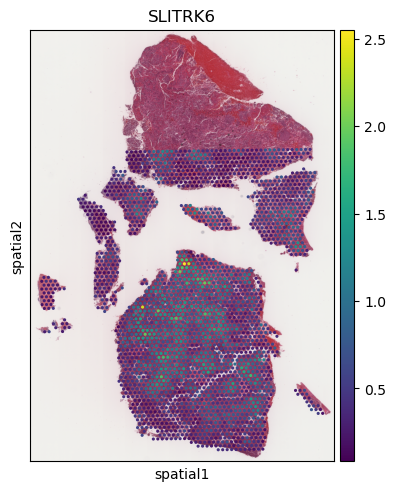

In [35]:
sq.pl.spatial_scatter(new, library_id='VLP79_A', color="SLITRK6")

In [13]:
adata = sq.read.visium("../data/pfizer/VLP79_A", library_id = 'VLP79_A', source_image_path = "../data/pfizer/" + "VLP79_A" + "/image.tif")
adata.obsm['spatial'] = adata.obsm['spatial'].astype(np.int64)


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


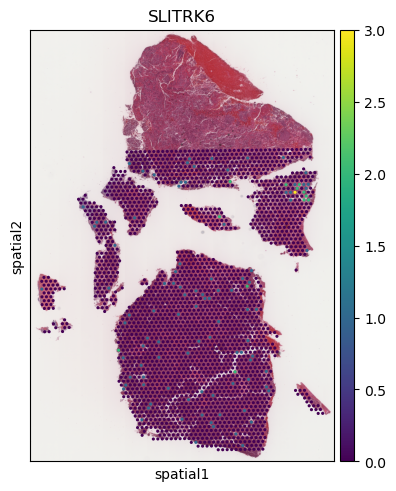

In [68]:
sq.pl.spatial_scatter(adata, library_id='VLP79_A', color="SLITRK6")

In [26]:
adata.obsm['spatial'].shape

(3155, 2)

In [42]:
adata.var_names

Index(['SAMD11', 'NOC2L', 'KLHL17', 'PLEKHN1', 'PERM1', 'HES4', 'ISG15',
       'AGRN', 'RNF223', 'C1orf159',
       ...
       'MT-ND2', 'MT-CO2', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4',
       'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object', length=18085)

In [44]:
cor_genes = pd.DataFrame(data=[data.var_names, )

In [15]:
from scipy import stats

def plot_correlation(df, attr_1, attr_2):
    r = stats.pearsonr(df[attr_1], 
                       df[attr_2])[0] **2

    g = sns.lmplot(data=df,
        x=attr_1, y=attr_2,
        height=5, legend=True
    )
    # g.set(ylim=(0, 360), xlim=(0,360))

    g.set_axis_labels(attr_1, attr_2)
    plt.annotate(r'$R^2:{0:.2f}$'.format(r),
                (max(df[attr_1])*0.9, max(df[attr_2])*0.9))
    return g


def calculate_correlation(attr_1, attr_2):
    r = stats.pearsonr(attr_1, 
                       attr_2)[0]
    return r

def calculate_correlation_2(attr_1, attr_2):
    r = stats.spearmanr(attr_1, 
                       attr_2)[0]
    return r


In [14]:
%mkdir results/

In [66]:
genes_10 = list(df.sort_values(by=['Pearson correlation'], ascending=False)['Gene'][:10])

In [32]:
def format_corr(gene,library_id):
    df = dfs[library_id]
    return np.round(list(df[df['Gene']==gene]['Pearson correlation'])[0],2)

In [103]:
new.var_names

Index(['ISG15', 'PIK3CD', 'FBXO2', 'SRARP', 'MFAP2', 'IGSF21', 'PLA2G2A',
       'PLA2G2D', 'CNR2', 'CD52',
       ...
       'TCEAL1', 'PLP1', 'DCX', 'SASH3', 'RAP2C', 'GPC4', 'GPC3', 'RTL8A',
       'CD40LG', 'MAGEA12'],
      dtype='object', length=1000)

In [35]:
gene_dict = {'Other': ["FABP4", "IL2RG", "SFRP2", "CHD2", "MT-ND1", "SCGB2A2", "CPB1", "KRT17"],
'Tumor': ["FASN", "FOXA1", "CEACAM6", "GATA3", "MZB1", "AGR3", "SERPINA3", "TACSTD2", "MKI67"],
'Mypoepithelial': ["KRT23", "ALDH1A3", "SFRP1", "KRT15", "MYLK", "ACTA2"],
'Stromal': ["GJB2", "SFRP4", "POSTN", "MMP2"],
'T cells': ["CXCR4", "CD8A", "TRAC", "CD4"] ,
'B cells': ["MS4A1", "BANK1"],
'Macrophage': ["APOC1", "MMP12", "C15orf48", "ITGAX", "CD68"],
'Endothelial': ["LRRC15", "AQP1", "VWF", "PECAM1"]}

In [36]:
gene_dict

{'Other': ['FABP4',
  'IL2RG',
  'SFRP2',
  'CHD2',
  'MT-ND1',
  'SCGB2A2',
  'CPB1',
  'KRT17'],
 'Tumor': ['FASN',
  'FOXA1',
  'CEACAM6',
  'GATA3',
  'MZB1',
  'AGR3',
  'SERPINA3',
  'TACSTD2',
  'MKI67'],
 'Mypoepithelial': ['KRT23', 'ALDH1A3', 'SFRP1', 'KRT15', 'MYLK', 'ACTA2'],
 'Stromal': ['GJB2', 'SFRP4', 'POSTN', 'MMP2'],
 'T cells': ['CXCR4', 'CD8A', 'TRAC', 'CD4'],
 'B cells': ['MS4A1', 'BANK1'],
 'Macrophage': ['APOC1', 'MMP12', 'C15orf48', 'ITGAX', 'CD68'],
 'Endothelial': ['LRRC15', 'AQP1', 'VWF', 'PECAM1']}

In [68]:
!pip install matplotlib-venn

  Using cached matplotlib-venn-0.11.9.tar.gz (30 kB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for matplotlib-venn: filename=matplotlib_venn-0.11.9-py3-none-any.whl size=32999 sha256=77e549c0abdb63ae26e7541f775b9df7d7c5d60f914477a3b0a2788af2dac10c
  Stored in directory: /scratch/imb/uqjxie6/.cache/wheels/19/91/e4/fade243cc0a0c6010b800f6073f48037670936676a23fe1187
Successfully built matplotlib-venn


In [69]:
from matplotlib_venn import venn3

In [89]:
top_genes = {k:list(df.sort_values(by=['Pearson correlation'], ascending=False)['Gene'][:250])
             for k,df in dfs.items()}

In [85]:
tuple(top_genes.keys())

('VLP79_A', 'VLP80_D', 'VLP83_A')

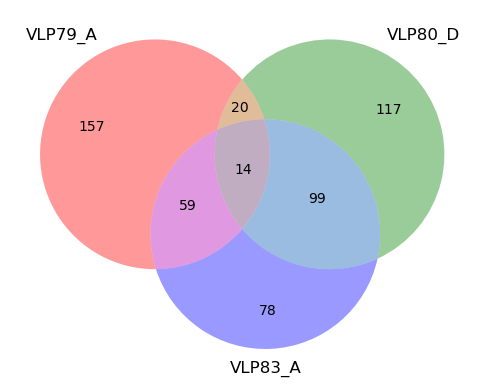

In [90]:
venn3(subsets=[set(top_genes[key]) for key in top_genes], set_labels=tuple(top_genes.keys()))
plt.savefig("results/venn.png")

In [88]:
for i in set.intersection(*[set(top_genes[key]) for key in top_genes]):
    print(i)

TSPAN1
ABCD3
MMP2
NQO1
ELN
NAT1
TM4SF1
CTDSPL
THBS2
FBLN2
KRT7
GPX3
FGFR2
COL10A1


In [66]:
top_genes

{'VLP79_A': ['SLC16A6',
  'MGST1',
  'CYB561',
  'FNBP1L',
  'SMARCD2',
  'RHOBTB3',
  'NDUFA4',
  'VCAN',
  'MUC20',
  'MGLL',
  'NANS',
  'ABCD3',
  'MMP2',
  'SERPINE1',
  'KRT7',
  'POR',
  'THBS2',
  'SLC7A5',
  'IFI27',
  'MID1IP1',
  'CORO2A',
  'GRIK3',
  'LPL',
  'TFAP2B',
  'SULF1',
  'CLEC3A',
  'KPNA2',
  'ANKRD42',
  'PSD3',
  'CTHRC1',
  'FGFR2',
  'ACTA2',
  'PFKFB3',
  'COL5A2',
  'GPNMB',
  'TPX2',
  'AIF1L',
  'PAM',
  'ISG15',
  'OSGIN1',
  'THY1',
  'PCM1',
  'MT2A',
  'MAPK8IP2',
  'FEZ1',
  'SEZ6L2',
  'RBBP7',
  'RET',
  'FAP',
  'SDR16C5',
  'GCLM',
  'SYT12',
  'KRT10',
  'RTL8A',
  'ABCA12',
  'EEF1A2',
  'ASAH1',
  'MBOAT2',
  'APOC1',
  'GPR108',
  'EFEMP1',
  'DPYSL3',
  'TF',
  'TMEM132A',
  'OLR1',
  'PBX3',
  'DR1',
  'HMOX1',
  'TESMIN',
  'ELN',
  'LRRC59',
  'CDH11',
  'PHF14',
  'DNMT3B',
  'CKB',
  'CEACAM6',
  'DNTTIP2',
  'GPATCH2',
  'MXRA5',
  'KCTD6',
  'LOXL2',
  'BAALC',
  'PTPRT',
  'NQO1',
  'COL8A1',
  'COL12A1',
  'ITGB4',
  'TNC',
  'PTP

In [64]:
dfs

{'VLP79_A':         Gene  Pearson correlation    Slide   Method
 0      ISG15             0.318804  VLP79_A  STimage
 1     PIK3CD            -0.092469  VLP79_A  STimage
 2      FBXO2            -0.008945  VLP79_A  STimage
 3      SRARP             0.017895  VLP79_A  STimage
 4      MFAP2             0.127767  VLP79_A  STimage
 ..       ...                  ...      ...      ...
 995     GPC4             0.099294  VLP79_A  STimage
 996     GPC3             0.008528  VLP79_A  STimage
 997    RTL8A             0.287896  VLP79_A  STimage
 998   CD40LG            -0.005400  VLP79_A  STimage
 999  MAGEA12             0.011913  VLP79_A  STimage
 
 [1000 rows x 4 columns],
 'VLP80_D':         Gene  Pearson correlation    Slide   Method
 0      ISG15            -0.046086  VLP80_D  STimage
 1     PIK3CD             0.284899  VLP80_D  STimage
 2      FBXO2             0.006737  VLP80_D  STimage
 3      SRARP             0.203132  VLP80_D  STimage
 4      MFAP2             0.090809  VLP80_D  STim

In [56]:
import os
for k,v in gene_dict.items():
    os.mkdir(f"results/{k}")

In [62]:
def save_plots(genes, dirr, library_id):
    new = test_adata[test_adata.obs['library_id']==library_id]
    adata = sq.read.visium(f"../data/pfizer/{library_id}", library_id = library_id, source_image_path = "../data/pfizer/" + library_id + "/image.tif")
    adata.obsm['spatial'] = adata.obsm['spatial'].astype(np.int64)

    for gene in genes:
        if gene in new.var_names and gene in adata.var_names:
            fig, axs = plt.subplots(1, 2, figsize=(20, 12))
            sq.pl.spatial_scatter(new, library_id=library_id, color=gene, title=f"{gene} - predicted (r={format_corr(gene, library_id)})", fig=fig, ax=axs[0])
            sq.pl.spatial_scatter(adata, library_id=library_id, color=gene, title=f"{gene} ground truth", fig=fig, ax=axs[1])
            plt.savefig(f"results/{dirr}/{library_id}-{gene}.png")
        else:
            print(f"{gene} not predicted")

In [ ]:
for k,v in gene_dict.items():
    save_plots(v, k, test_list[0])

/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


CHD2 not predicted
MT-ND1 not predicted
CPB1 not predicted


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


FASN not predicted
FOXA1 not predicted
GATA3 not predicted
AGR3 not predicted
TACSTD2 not predicted


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


ALDH1A3 not predicted
MYLK not predicted


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


CD8A not predicted


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/tmp/ipykernel_173378/1007920337.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 2, figsize=(20, 12))
/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


MMP12 not predicted
ITGAX not predicted
CD68 not predicted


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AQP1 not predicted
VWF not predicted
PECAM1 not predicted


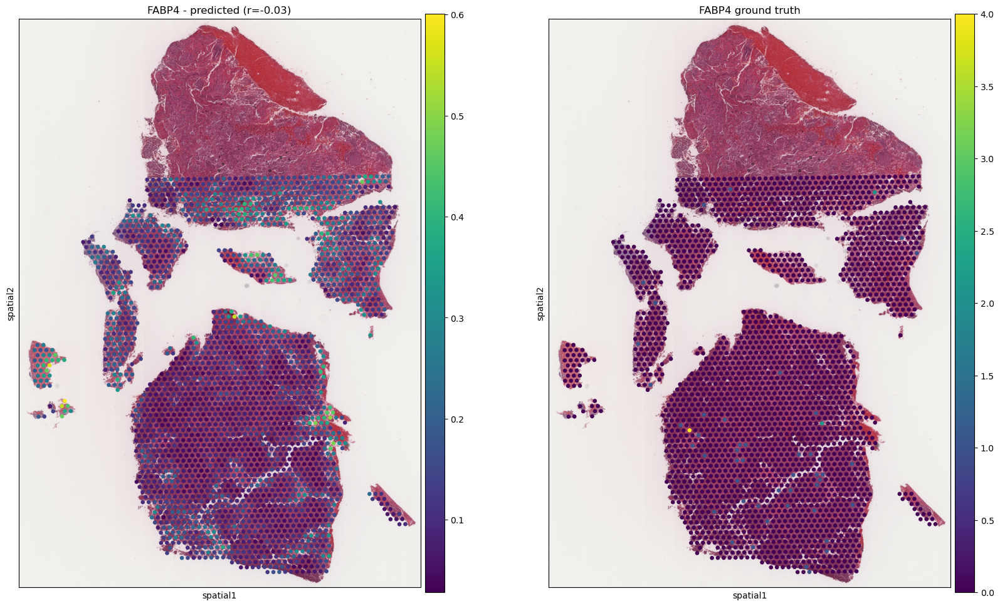

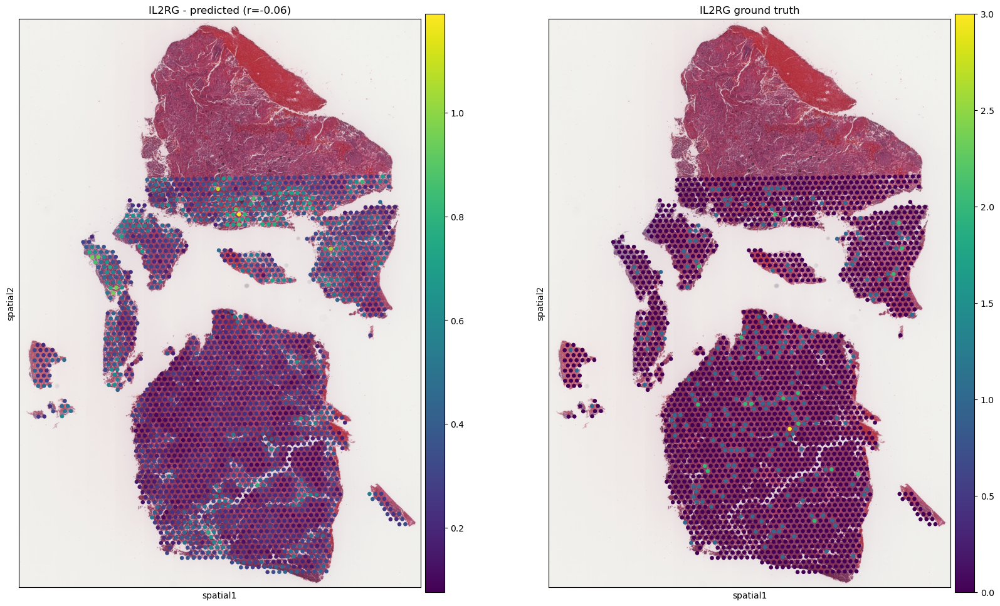

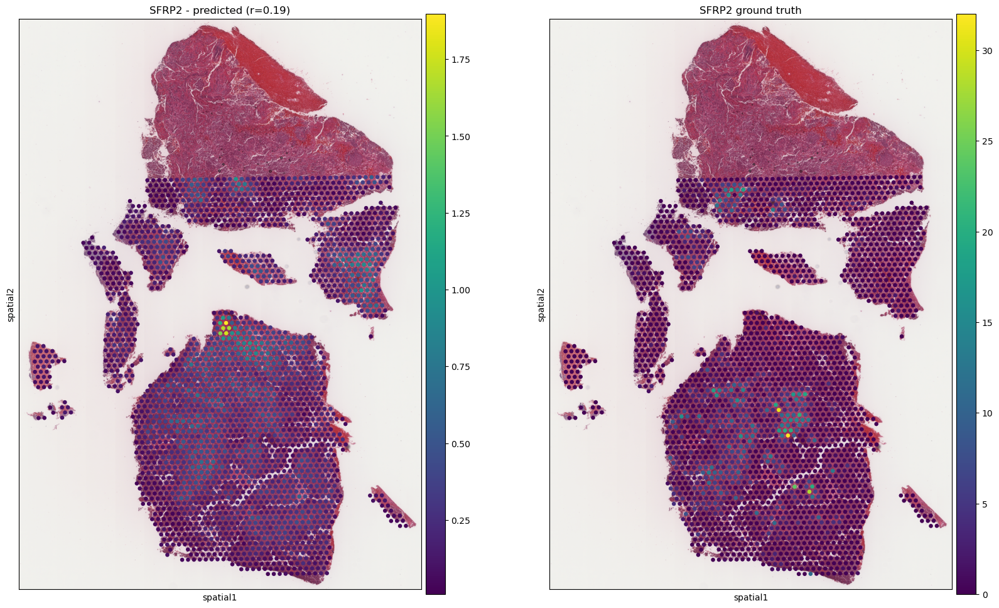

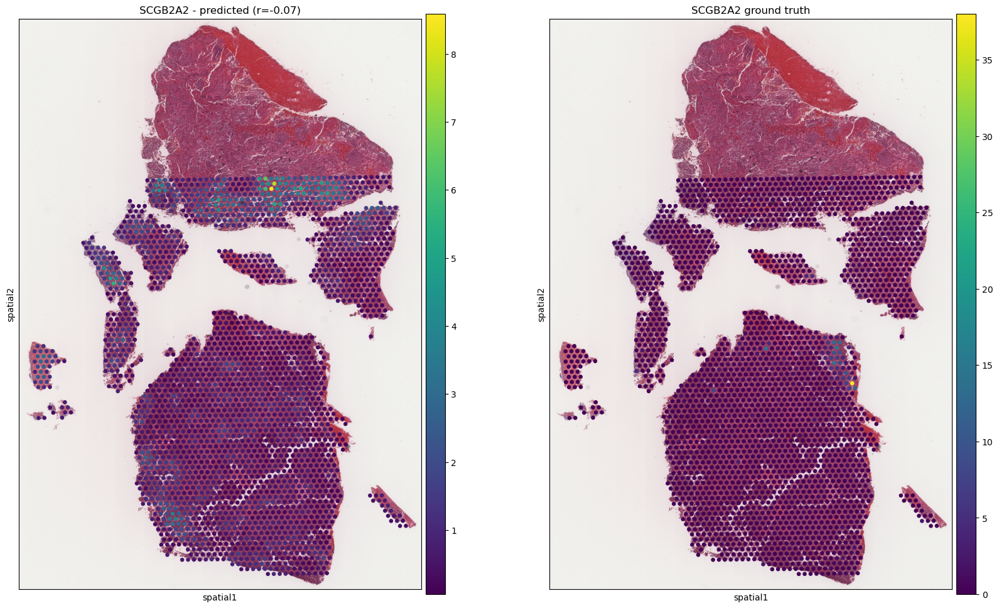

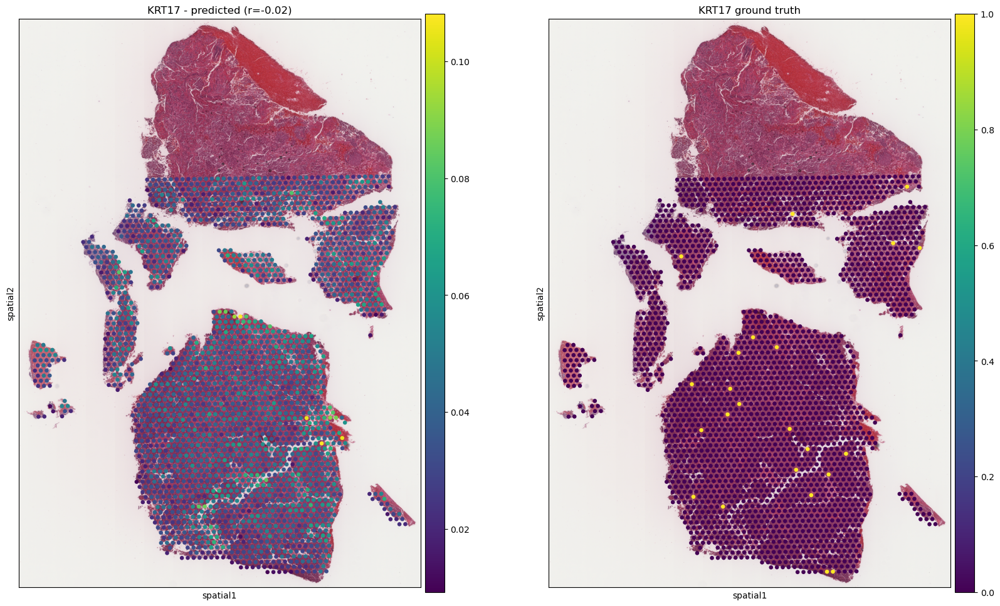

...

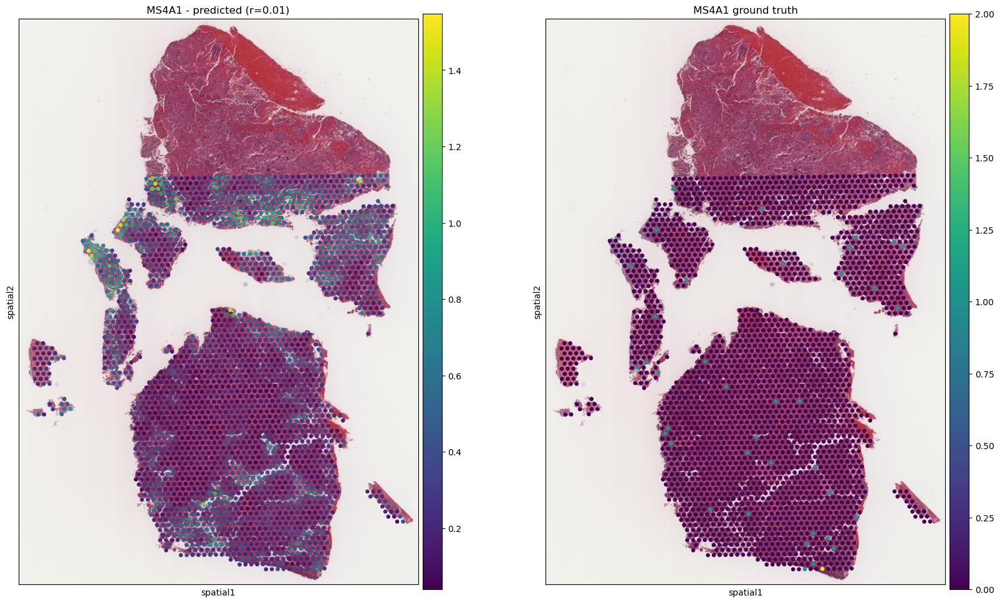

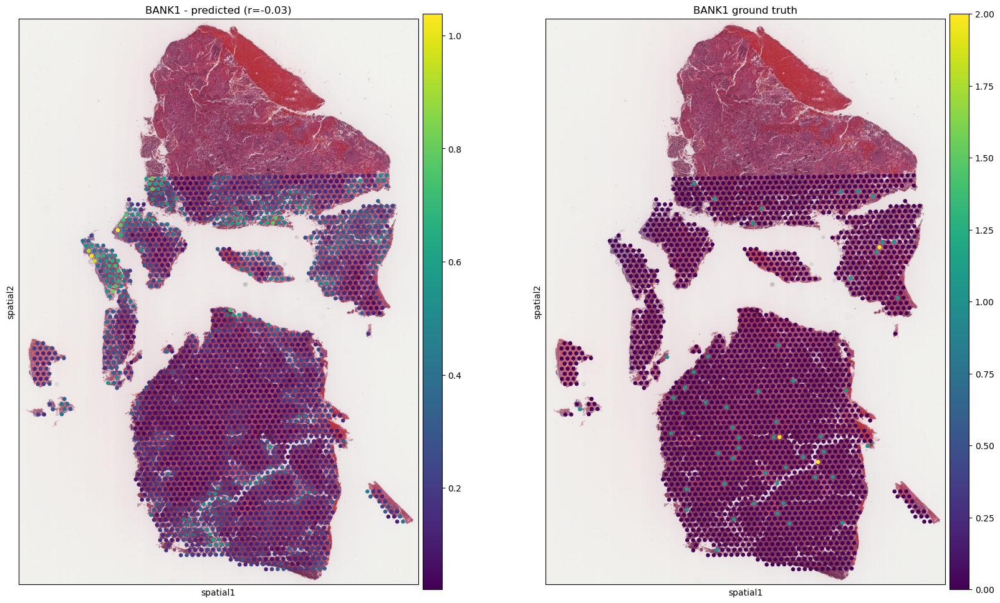

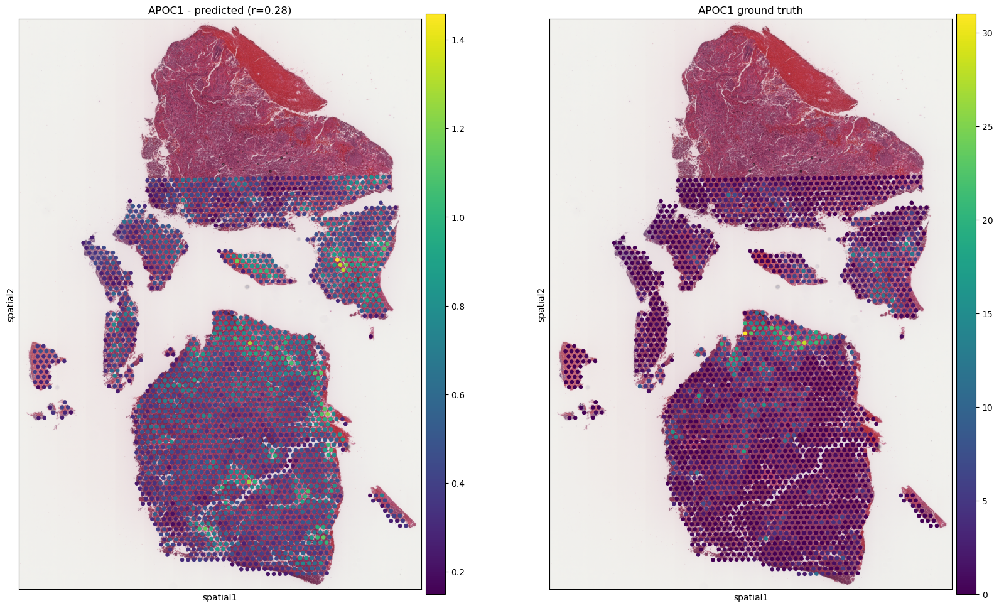

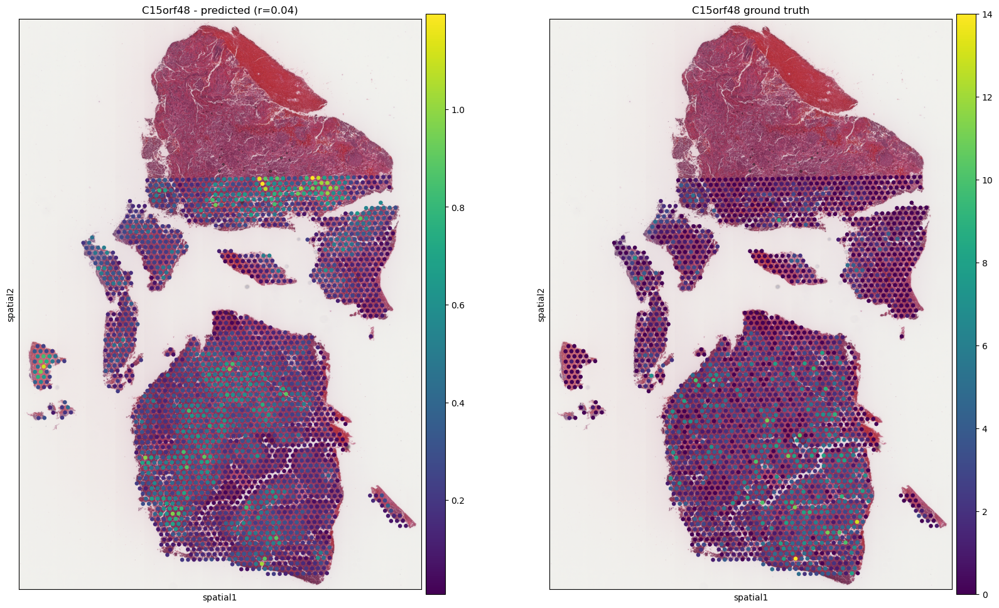

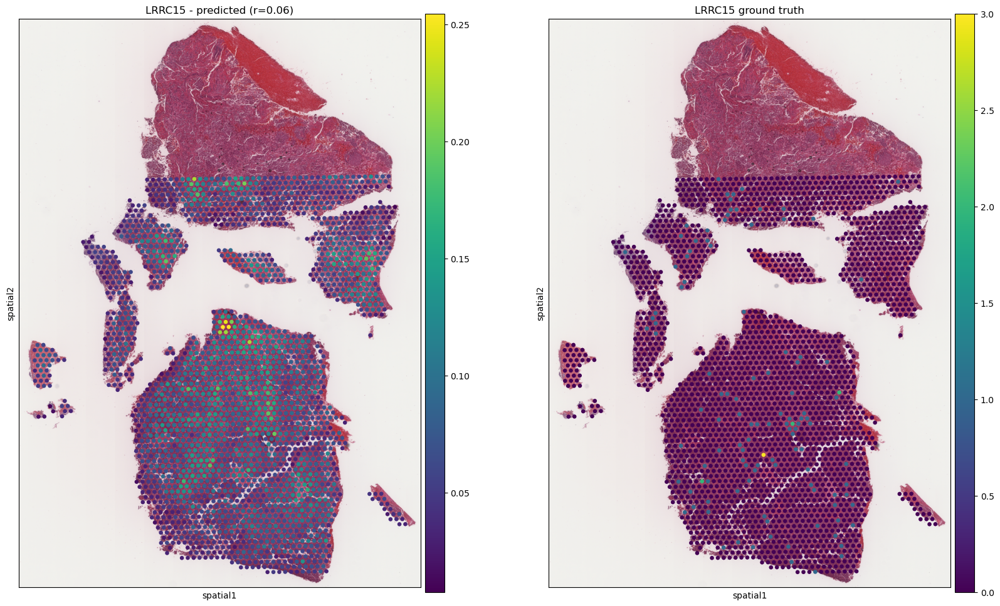

In [63]:
for k,v in gene_dict.items():
    save_plots(v, k, test_list[0])

In [16]:
# # fig, axs = plt.subplots(10, 2, figsize=(16, 40))
# # fig.subplots_adjust(wspace=1, hspace=1)

# plt.figure()

# for i,gene in enumerate(genes_10):
#     sq.pl.spatial_scatter(new, library_id='VLP79_A', color=gene, title=f"{gene} - predicted (r={format_corr(gene)})")
#     sq.pl.spatial_scatter(adata, library_id='VLP79_A', color=gene, title=f"{gene} ground truth")
#     plt.savefig(f"{gene}.png")
    


In [17]:
# fig, axs = plt.subplots(10, 2, figsize=(16, 40))
# fig.subplots_adjust(wspace=1, hspace=1)

# for i,gene in enumerate(genes_10):
#     sq.pl.spatial_scatter(new, library_id='VLP79_A', color=gene, title="predicted", fig=fig, ax=axs[i,0])
#     sq.pl.spatial_scatter(adata, library_id='VLP79_A', color=gene, title="ground truth", fig=fig, ax=axs[i,1])

In [91]:
df.shape

(1000, 4)

<Axes: >

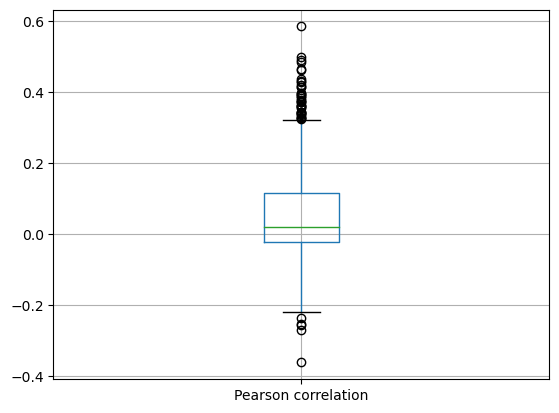

In [94]:
df.boxplot(column='Pearson correlation')

In [37]:
dfs

{'VLP79_A':         Gene  Pearson correlation    Slide   Method
 0      ISG15             0.318804  VLP79_A  STimage
 1     PIK3CD            -0.092469  VLP79_A  STimage
 2      FBXO2            -0.008945  VLP79_A  STimage
 3      SRARP             0.017895  VLP79_A  STimage
 4      MFAP2             0.127767  VLP79_A  STimage
 ..       ...                  ...      ...      ...
 995     GPC4             0.099294  VLP79_A  STimage
 996     GPC3             0.008528  VLP79_A  STimage
 997    RTL8A             0.287896  VLP79_A  STimage
 998   CD40LG            -0.005400  VLP79_A  STimage
 999  MAGEA12             0.011913  VLP79_A  STimage
 
 [1000 rows x 4 columns],
 'VLP80_D':         Gene  Pearson correlation    Slide   Method
 0      ISG15            -0.046086  VLP80_D  STimage
 1     PIK3CD             0.284899  VLP80_D  STimage
 2      FBXO2             0.006737  VLP80_D  STimage
 3      SRARP             0.203132  VLP80_D  STimage
 4      MFAP2             0.090809  VLP80_D  STim

In [46]:
test_list

['VLP79_A', 'VLP80_D', 'VLP83_A']

In [49]:
[v['Pearson correlation'] for k,v in dfs.items()][0]

0      0.318804
1     -0.092469
2     -0.008945
3      0.017895
4      0.127767
         ...   
995    0.099294
996    0.008528
997    0.287896
998   -0.005400
999    0.011913
Name: Pearson correlation, Length: 1000, dtype: float64

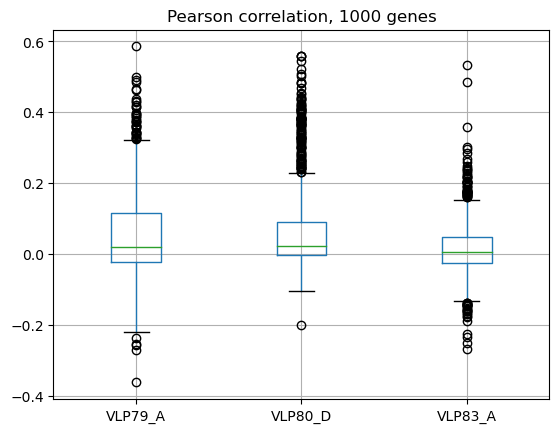

In [54]:
alldf = pd.DataFrame()
for i in test_list:
    alldf[i] = dfs[i]['Pearson correlation']
alldf.boxplot(column=test_list)
plt.title('Pearson correlation, 1000 genes')
plt.savefig(f"results/boxplot-1000.png")

In [40]:
dfs

{'VLP79_A':         Gene  Pearson correlation    Slide   Method
 0      ISG15             0.318804  VLP79_A  STimage
 1     PIK3CD            -0.092469  VLP79_A  STimage
 2      FBXO2            -0.008945  VLP79_A  STimage
 3      SRARP             0.017895  VLP79_A  STimage
 4      MFAP2             0.127767  VLP79_A  STimage
 ..       ...                  ...      ...      ...
 995     GPC4             0.099294  VLP79_A  STimage
 996     GPC3             0.008528  VLP79_A  STimage
 997    RTL8A             0.287896  VLP79_A  STimage
 998   CD40LG            -0.005400  VLP79_A  STimage
 999  MAGEA12             0.011913  VLP79_A  STimage
 
 [1000 rows x 4 columns],
 'VLP80_D':         Gene  Pearson correlation    Slide   Method
 0      ISG15            -0.046086  VLP80_D  STimage
 1     PIK3CD             0.284899  VLP80_D  STimage
 2      FBXO2             0.006737  VLP80_D  STimage
 3      SRARP             0.203132  VLP80_D  STimage
 4      MFAP2             0.090809  VLP80_D  STim

TypeError: boxplot() got an unexpected keyword argument 'title'

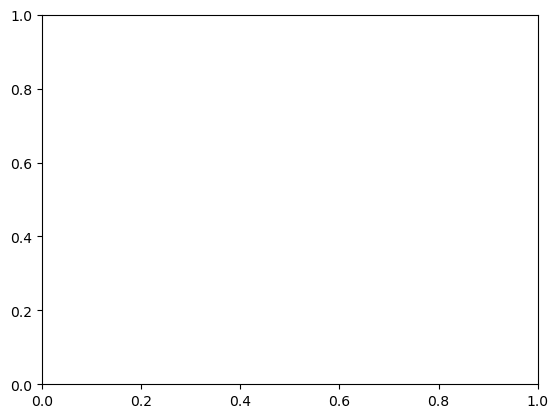

In [39]:
for k,v in dfs.items():
    plt.figure()
    v.boxplot(column='Pearson correlation', title=f"{k} - Pearson correlation, n={v.shape[0]} genes")
    plt.savefig(f"results/boxplot-{k}.png")

In [90]:
print(df['Pearson correlation'].min())
print(df['Pearson correlation'].max())
print(df['Pearson correlation'].mean())

-0.36144278345540315
0.5856417497209515
0.05422790331398205


In [18]:
test_list

['VLP79_A', 'VLP80_D', 'VLP83_A']

In [30]:
# dfs = {i:pd.DataFrame() for i in test_list}
dfs

{'VLP79_A':          Gene  Pearson correlation    Slide   Method
 0       ISG15             0.318804  VLP79_A  STimage
 1      PIK3CD            -0.092469  VLP79_A  STimage
 2       FBXO2            -0.008945  VLP79_A  STimage
 3       SRARP             0.017895  VLP79_A  STimage
 4       MFAP2             0.127767  VLP79_A  STimage
 ...       ...                  ...      ...      ...
 1995     GPC4             0.099294  VLP79_A  STimage
 1996     GPC3             0.008528  VLP79_A  STimage
 1997    RTL8A             0.287896  VLP79_A  STimage
 1998   CD40LG            -0.005400  VLP79_A  STimage
 1999  MAGEA12             0.011913  VLP79_A  STimage
 
 [2000 rows x 4 columns],
 'VLP80_D':         Gene  Pearson correlation    Slide   Method
 0      ISG15            -0.046086  VLP80_D  STimage
 1     PIK3CD             0.284899  VLP80_D  STimage
 2      FBXO2             0.006737  VLP80_D  STimage
 3      SRARP             0.203132  VLP80_D  STimage
 4      MFAP2             0.090809  V

In [21]:
results = {i:test_adata[test_adata.obs['library_id']==i] for i in test_list}

In [22]:
results

{'VLP79_A': View of AnnData object with n_obs × n_vars = 2301 × 1000
     obs: 'in_tissue', 'array_row', 'array_col', 'sum_counts', 'imagecol', 'imagerow', 'tile_tissue_mask_path', 'tissue_area', 'tile_path', 'library_id'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
     uns: 'hvg', 'spatial'
     obsm: 'predicted_gene', 'spatial',
 'VLP80_D': View of AnnData object with n_obs × n_vars = 3258 × 1000
     obs: 'in_tissue', 'array_row', 'array_col', 'sum_counts', 'imagecol', 'imagerow', 'tile_tissue_mask_path', 'tissue_area', 'tile_path', 'library_id'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
     uns: 'hvg', 'spatial'
     obsm: 'predicted_gene', 'spatial',
 'VLP83_A': View of AnnData object with n_obs × n_vars = 4579 × 1000
     obs: 'in_tissue', 'array_row', 'array_col', 'sum_counts', 'imagecol', 'imagerow', 'tile_tissue_mask_path', 'tissue_area', 'til

In [31]:
dfs = {i:pd.DataFrame() for i in test_list}

for i in test_list:
    new = test_adata[test_adata.obs['library_id']==i]
    pred_adata = new.copy()
    test_dataset = sq.read.visium(f"../data/pfizer/{i}", library_id = i, source_image_path = "../data/pfizer/" + i + "/image.tif")
    test_dataset.obsm['spatial'] = test_dataset.obsm['spatial'].astype(np.int64)
    # df = pd.DataFrame()

    for gene in pred_adata.var_names:
        cor_val = calculate_correlation(pred_adata.to_df().loc[:,gene], test_dataset.to_df().loc[:,gene]);
        dfs[i] = dfs[i].append(pd.Series([gene, cor_val, i, "STimage"], 
                             index=["Gene", "Pearson correlation", "Slide", "Method"]),
                      ignore_index=True);


/scratch/imb/uqjxie6/software/stimage5/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/tmp/ipykernel_173378/2434999676.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dfs[i] = dfs[i].append(pd.Series([gene, cor_val, i, "STimage"],
/tmp/ipykernel_173378/2434999676.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dfs[i] = dfs[i].append(pd.Series([gene, cor_val, i, "STimage"],
/tmp/ipykernel_173378/2434999676.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dfs[i] = dfs[i].append(pd.Series([gene, cor_val, i, "STimage"],
/tmp/ipykernel_173378/2434999676.py:12: FutureWarnin

<Axes: >

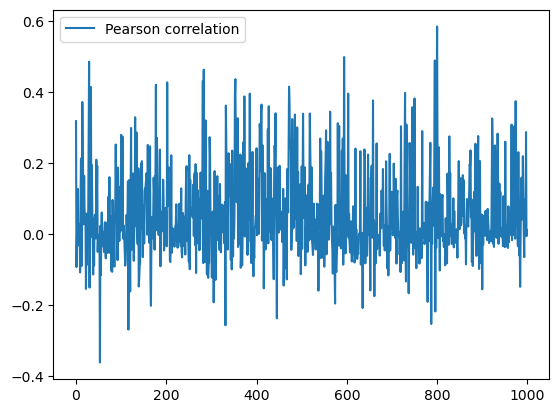

In [57]:
df[['Gene','Pearson correlation']].plot()

<Axes: >

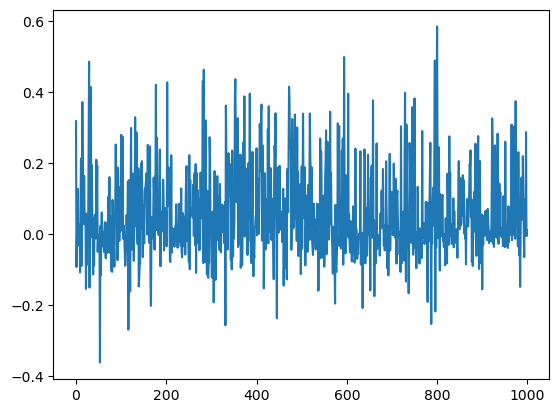

In [60]:
df['Pearson correlation'].plot()

In [55]:
df

,Gene,Pearson correlation,Slide,Method
0,ISG15,0.318804,VLP79_A,STimage
1,PIK3CD,-0.092469,VLP79_A,STimage
2,FBXO2,-0.008945,VLP79_A,STimage
3,SRARP,0.017895,VLP79_A,STimage
4,MFAP2,0.127767,VLP79_A,STimage
...,...,...,...,...
995,GPC4,0.099294,VLP79_A,STimage
996,GPC3,0.008528,VLP79_A,STimage
997,RTL8A,0.287896,VLP79_A,STimage
998,CD40LG,-0.005400,VLP79_A,STimage
